In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_california_housing
cal_housing = fetch_california_housing(data_home='.')
print(cal_housing.DESCR);

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block group
        - HouseAge      median house age in block group
        - AveRooms      average number of rooms per household
        - AveBedrms     average number of bedrooms per household
        - Population    block group population
        - AveOccup      average number of household members
        - Latitude      block group latitude
        - Longitude     block group longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived

In [2]:
cal_housing.target

array([4.526, 3.585, 3.521, ..., 0.923, 0.847, 0.894])

In [3]:
X = cal_housing.data
avg_price = cal_housing.target
feature_names = cal_housing.feature_names
feature_names

['MedInc',
 'HouseAge',
 'AveRooms',
 'AveBedrms',
 'Population',
 'AveOccup',
 'Latitude',
 'Longitude']

In [5]:
import pandas as pd
df=pd.DataFrame(np.hstack([X,avg_price[:,np.newaxis]]),columns=np.hstack([feature_names,'price']))
#Example of the first few rows of data (using the "head" command)
df

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,price
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422
...,...,...,...,...,...,...,...,...,...
20635,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09,0.781
20636,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21,0.771
20637,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22,0.923
20638,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32,0.847


# First part: Plots each data point on a Longitude Latitude map of California with price indicated in some fashion according to what you think is best (e.g., annotations, coloring, alpha values, marker size, surfaces, parallel plots, etc. the choice is yours).

In [7]:
import plotly.express as px
    
fig = px.scatter(df, x='Longitude', y="Latitude",color='price');
fig.update_layout(
    autosize=False,
    width=650,
    height=500,)

fig.show()


# Part two: Allow users to interact with this map by enabling interactive filtering on other features like minimums and maximums of HouseAge, AveRooms, AveBedrms, AveOccup, etc. such that the dataset being plotted can be manipulated or reduced interactively.

I tried different libraries to get a fine result as required. I'm keeping the different libraries for reference. In the following order: 

1- Folium Library that implements the points on an actual map like google maps. I found it really interesting to make it interactive on an actual map but I didn't manage to make it work interactively. However, the points are successfully plotted on the map 

2- Bokeh Plotting library that set up HTML interactive plot, either in the notebook itself or in a new html window. The graph plotted below has all the required features with the plot that you can hover over the data points to have all the features shown. Also, I added a custom JS feature in bokeh to edit the plot and add the sliders to filter the data and change the plot accordingly. For some reason it didn't work properly, but I debugged the code and the data changes successfully but it doesn't show up on the graph. 

3- Finally, the one that worked with me was plotly express and ipywidgets. You will find it right below this cell after installing the required package. I added a slider for each feature for the user to filter the range he wants for each feature, and the plot updates accordingly. 

In [19]:
pip install "ipywidgets==7.5"

Note: you may need to restart the kernel to use updated packages.


In [30]:
import plotly.express as px
import ipywidgets as widgets

# extract the 'Longitude' and 'Latitude' columns
df_plot = df[['Longitude', 'Latitude']]

# create the main figure using plotly
fig = px.scatter(df_plot, x='Longitude', y='Latitude')

# create sliders for filtering data based on HouseAge and price
house_age_slider = widgets.IntRangeSlider(
    value=[df['HouseAge'].min(), df['HouseAge'].max()],
    min=df['HouseAge'].min(),
    max=df['HouseAge'].max(),
    step=1,
    description='House Age Range:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

price_slider = widgets.IntRangeSlider(
    value=[df['price'].min(), df['price'].max()],
    min=df['price'].min(),
    max=df['price'].max(),
    step=1,
    description='Price Range:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

med_inc_slider = widgets.IntRangeSlider(
    value=[df['MedInc'].min(), df['MedInc'].max()],
    min=df['MedInc'].min(),
    max=df['MedInc'].max(),
    step=1,
    description='Median Income Range:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

ave_rooms_slider = widgets.IntRangeSlider(
    value=[df['AveRooms'].min(), df['AveRooms'].max()],
    min=df['AveRooms'].min(),
    max=df['AveRooms'].max(),
    step=1,
    description='Average Rooms Range:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

ave_bedrms_slider = widgets.IntRangeSlider(
    value=[df['AveBedrms'].min(), df['AveBedrms'].max()],
    min=df['AveBedrms'].min(),
    max=df['AveBedrms'].max(),
    step=1,
    description='Average Bedrooms Range:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

pop_slider = widgets.IntRangeSlider(
    value=[df['Population'].min(), df['Population'].max()],
    min=df['Population'].min(),
    max=df['Population'].max(),
    step=1,
    description='Population Range:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

ave_occup_slider = widgets.IntRangeSlider(
    value=[df['AveOccup'].min(), df['AveOccup'].max()],
    min=df['AveOccup'].min(),
    max=df['AveOccup'].max(),
    step=1,
    description='Average Occupancy Range:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

# function for filtering data based on selected range
def filter_data(house_age_range, price_range, med_inc_range, ave_rooms_range, ave_bedrms_range, pop_range, ave_occup_range):
    filtered_df = df[(df['HouseAge'] >= house_age_range[0]) & (df['HouseAge'] <= house_age_range[1]) &
                     (df['price'] >= price_range[0]) & (df['price'] <= price_range[1]) &
                     (df['MedInc'] >= med_inc_range[0]) & (df['MedInc'] <= med_inc_range[1]) &
                     (df['AveRooms'] >= ave_rooms_range[0]) & (df['AveRooms'] <= ave_rooms_range[1]) &
                     (df['AveBedrms'] >= ave_bedrms_range[0]) & (df['AveBedrms'] <= ave_bedrms_range[1]) &
                     (df['Population'] >= pop_range[0]) & (df['Population'] <= pop_range[1]) &
                     (df['AveOccup'] >= ave_occup_range[0]) & (df['AveOccup'] <= ave_occup_range[1])]
    fig.data[0].x = filtered_df['Longitude']
    fig.data[0].y = filtered_df['Latitude']

# observe sliders and filter data based on selected range
widgets.interactive(filter_data, house_age_range=house_age_slider, price_range=price_slider,
                    med_inc_range=med_inc_slider, ave_rooms_range=ave_rooms_slider,
                    ave_bedrms_range=ave_bedrms_slider, pop_range=pop_slider,
                    ave_occup_range=ave_occup_slider)



interactive(children=(IntRangeSlider(value=(1, 52), continuous_update=False, description='House Age Range:', m…

In [37]:
# show the figure 
fig.show() # You need to run this cell everytime you change the sliders above  


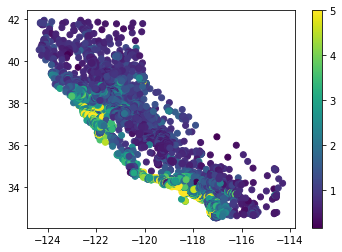

In [10]:
# Extract longitude and latitude values from X
longitude = X[:, 7]
latitude = X[:, 6]

In [38]:
# 1) Folium library: 

import folium

# create the map
m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=8)

# add a marker for each datapoint
for lat, lon, price in zip(df['Latitude'], df['Longitude'], df['price']):
    folium.CircleMarker([lat, lon], radius=5, color='blue', fill=True, fill_color='blue', fill_opacity=0.5).add_to(m)

# show the map
m

In [13]:
#2 Bokeh plotting library 

import pandas as pd
import numpy as np
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource, HoverTool, Slider, Range1d
from sklearn.datasets import fetch_california_housing

cal_housing = fetch_california_housing(data_home='.')
X = cal_housing.data
avg_price = cal_housing.target
feature_names = cal_housing.feature_names
df=pd.DataFrame(np.hstack([X,avg_price[:,np.newaxis]]),columns=np.hstack([feature_names,'price']))


source = ColumnDataSource(data=dict(
    x=df['Longitude'],
    y=df['Latitude'],
    price=df['price'],
    age=df['HouseAge'],
    rooms=df['AveRooms'],
    bedrms=df['AveBedrms'],
    pop=df['Population'],
    occ=df['AveOccup'],
    medinc=df['MedInc']
))



In [39]:
# Set up the figure
plot = figure(
    x_axis_label='Longitude',
    y_axis_label='Latitude',
    x_range=Range1d(-124.5, -114.0),
    y_range=Range1d(32.5, 42.0),
    tools='pan, wheel_zoom, reset'
)

# Add the points to the figure
plot.circle('x', 'y', source=source, color='blue')

# Set up the sliders
medinc_slider = Slider(start=0, end=15, value=0, step=0.1, title='MedInc')
age_slider = Slider(start=0, end=50, value=0, step=1, title='HouseAge')
rooms_slider = Slider(start=0, end=10, value=0, step=1, title='AveRooms')
bedrms_slider = Slider(start=0, end=5, value=0, step=1, title='AveBedrms')
pop_slider = Slider(start=0, end=15000, value=0, step=500, title='Population')
occ_slider = Slider(start=0, end=15, value=0, step=1, title='AveOccup')


In [40]:
from bokeh.models import CustomJS

# Set up the update callback
callback = CustomJS(args=dict(source=source, medinc_slider=medinc_slider, age_slider=age_slider, rooms_slider=rooms_slider, bedrms_slider=bedrms_slider, pop_slider=pop_slider, occ_slider=occ_slider), code="""
    var data = source.data;
    var medinc = data['medinc'];
    var age = data['age'];
    var rooms = data['rooms'];
    var bedrms = data['bedrms'];
    var pop = data['pop'];
    var occ = data['occ'];
    var price = data['price'];
    
    var medinc_min = medinc_slider.value;
    var age_min = age_slider.value;
    var rooms_min = rooms_slider.value;
    var bedrms_min = bedrms_slider.value;
    var pop_min = pop_slider.value;
    var occ_min = occ_slider.value;
    
    x = data['x']
    y = data['y']
    
    source.data['x'] = []
    source.data['y'] = []
    source.data['price'] = []
    source.data['medinc'] = []
    source.data['age'] = []
    source.data['rooms'] = []
    source.data['bedrms'] = []
    source.data['pop'] = []
    source.data['occ'] = []
    
    for (i = 0; i < x.length; i++) {
        if (medinc[i] >= medinc_min || age[i] >= age_min || rooms[i] >= rooms_min || bedrms[i] >= bedrms_min || pop[i] >= pop_min || occ[i] >= occ_min) {
            source.data['x'].push(x[i])
            source.data['y'].push(y[i])
            source.data['price'].push(price[i])
            source.data['medinc'].push(medinc[i])
            source.data['age'].push(age[i])
            source.data['rooms'].push(rooms[i])
            source.data['bedrms'].push(bedrms[i])
            source.data['pop'].push(pop[i])
            source.data['occ'].push(occ[i])
        }
    }
    
    source.change.emit();
""")


In [41]:
# Attach the update callback to the sliders
medinc_slider.js_on_change('value', callback)
age_slider.js_on_change('value', callback)
rooms_slider.js_on_change('value', callback)
bedrms_slider.js_on_change('value', callback)
pop_slider.js_on_change('value', callback)
occ_slider.js_on_change('value', callback)

# Set up the hover tool
hover = HoverTool(tooltips=[
    ('Price', '@price'),
    ('MedInc', '@medinc'),
    ('HouseAge', '@age'),
    ('AveRooms', '@rooms'),
    ('AveBedrms', '@bedrms'),
    ('Population', '@pop'),
    ('AveOccup', '@occ')
])

# Add the hover tool to the plot
plot.add_tools(hover)


# Arrange the sliders and the plot in a column
show(column(medinc_slider, age_slider, rooms_slider, bedrms_slider, pop_slider, occ_slider, plot))

